In [3]:
import numpy as np
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import matplotlib.pyplot as plt
import seaborn as sns

In [85]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=10, frameon=True, figsize=(2, 2), transparent=False, format="pdf")

-----
anndata     0.7.5
scanpy      1.8.1
sinfo       0.3.1
-----
PIL                 8.1.1
anndata             0.7.5
anyio               NA
argon2              20.1.0
asciitree           NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
beta_ufunc          NA
binom_ufunc         NA
brotli              NA
cairo               1.20.0
certifi             2021.10.08
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.3.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
dask                2021.02.0
dateutil            2.8.1
decorator           4.4.2
fasteners           NA
future_fstrings     NA
google              NA
h5py                2.10.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_serv

In [5]:
intestine_integrated = sc.read_h5ad("./../../../pyobjs_github/intestine_1.h5ad")

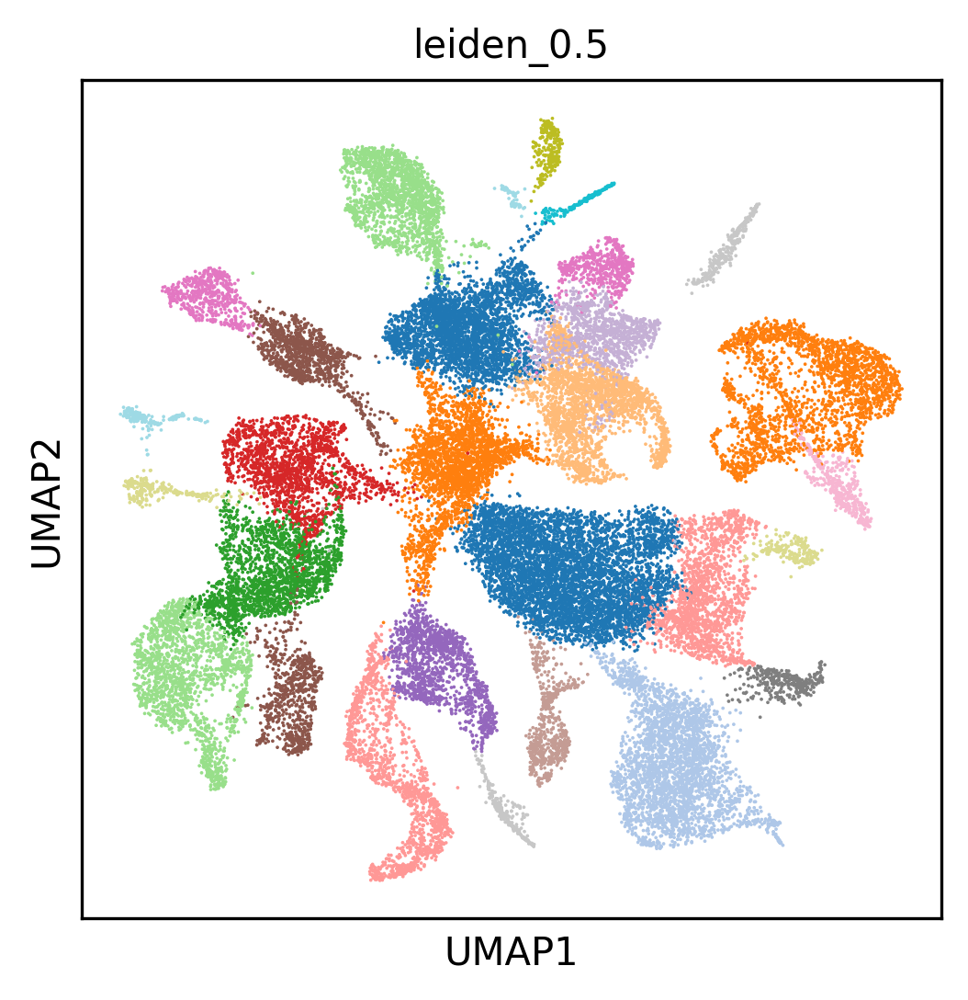

In [6]:
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=10, frameon=True, figsize=(4, 4), transparent=False, format="pdf")
sc.pl.umap(intestine_integrated, color = ["leiden_0.5"], palette="tab20", legend_loc = "none")

In [8]:
muscle_clusters = ["1", "5", "7", "13", "17", "23", "26", "28"]
intestine_muscle = intestine_integrated.raw.to_adata()[intestine_integrated.obs['leiden_0.5'].isin(muscle_clusters)]
print(intestine_muscle)

View of AnnData object with n_obs × n_vars = 9445 × 19652
    obs: 'sample', 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase', 'leiden_0.3', 'leiden_0.5'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_0.3_colors', 'leiden_0.5_colors', 'leiden_0.5_sizes', 'neighbors', 'paga', 'pca', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'


/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


extracting highly variable genes
    finished (0:00:01)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


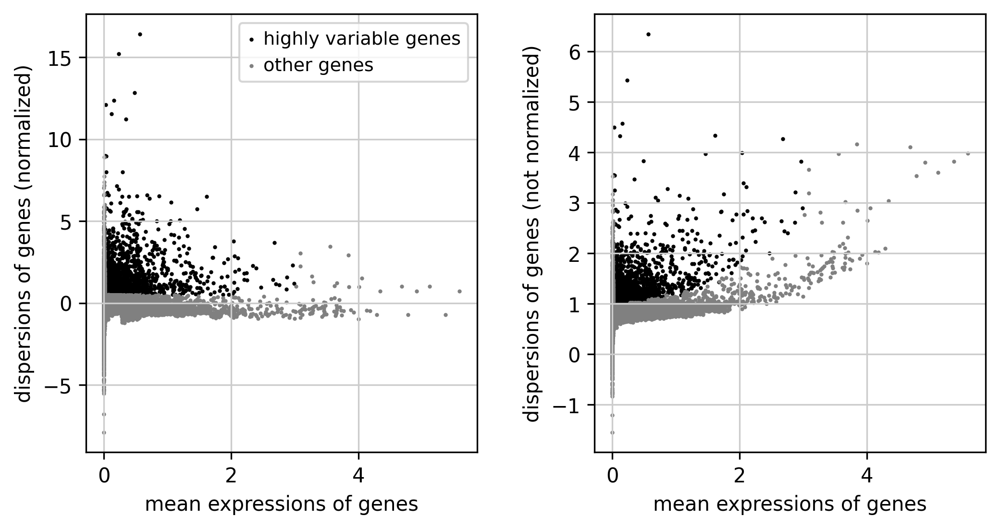

regressing out ['total_counts', 'pct_counts_mt', 'S_score', 'G2M_score']
    sparse input is densified and may lead to high memory use
    finished (0:01:11)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:14)


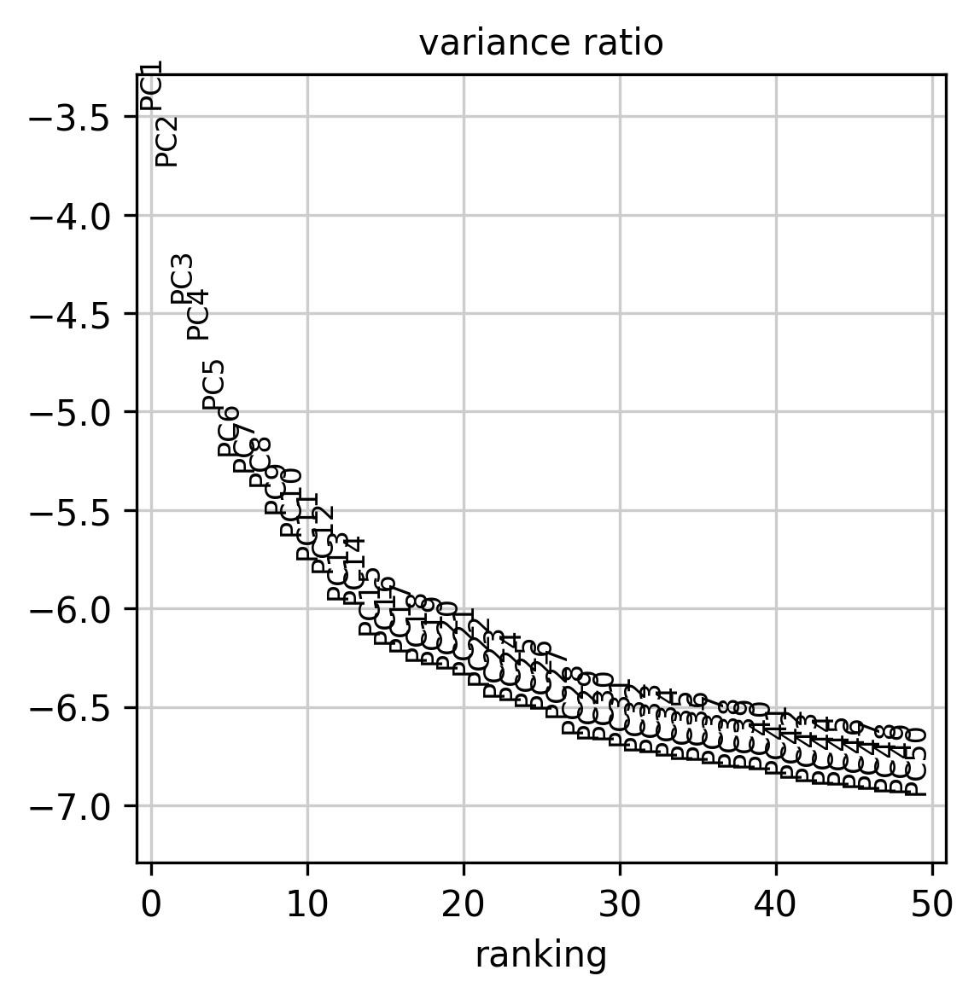

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:40)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)
running Leiden clustering
    finished: found 15 clusters and added
    'muscle_leiden_0.5', the cluster labels (adata.obs, categorical) (0:00:00)


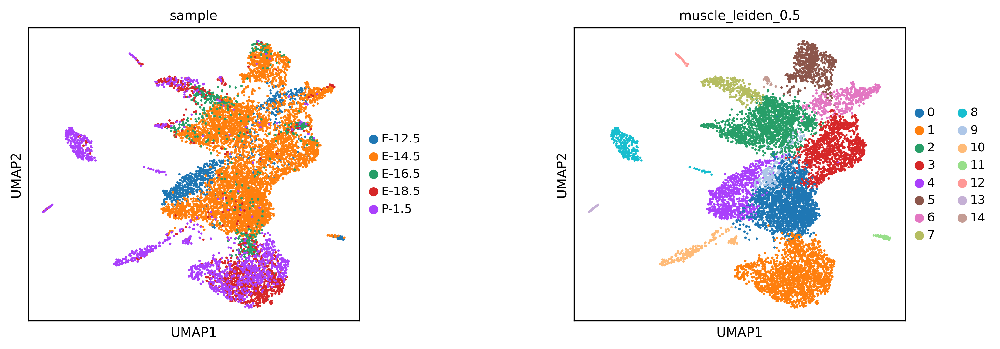

In [9]:
sc.pp.highly_variable_genes(intestine_muscle, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(intestine_muscle)
intestine_muscle.raw = intestine_muscle
intestine_muscle = intestine_muscle[:, intestine_muscle.var.highly_variable]
sc.pp.regress_out(intestine_muscle, ['total_counts', 'pct_counts_mt', 'S_score', 'G2M_score'], n_jobs=20)
sc.pp.scale(intestine_muscle, max_value=10)
sc.tl.pca(intestine_muscle, svd_solver='arpack', random_state=0)
sc.pl.pca_variance_ratio(intestine_muscle, n_pcs = 50, log=True)
sc.pp.neighbors(intestine_muscle, n_pcs=30)
sc.tl.umap(intestine_muscle)
sc.tl.leiden(intestine_muscle, key_added="muscle_leiden_0.5", resolution = 0.5)
sc.pl.umap(intestine_muscle, color=["sample", "muscle_leiden_0.5"], wspace=0.5)

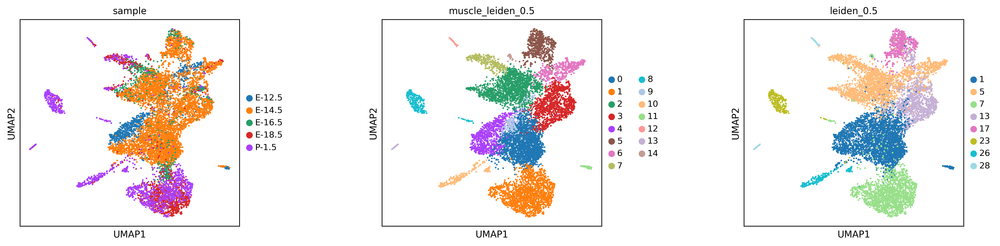

In [10]:
sc.pl.umap(intestine_muscle, color=["sample", "muscle_leiden_0.5", "leiden_0.5"], wspace=0.5)

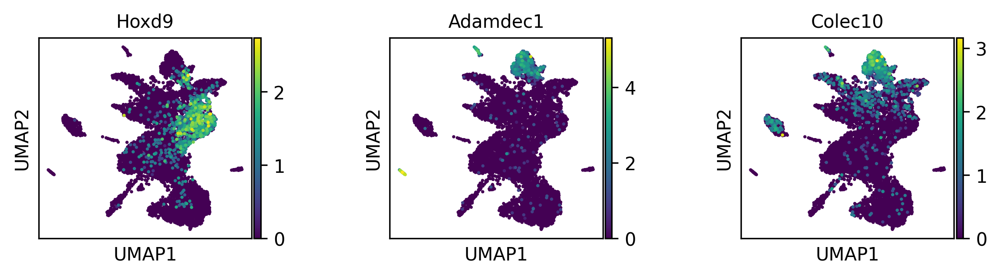

In [69]:
sc.pl.umap(intestine_muscle, color=["Hoxd9", "Adamdec1", "Colec10"], wspace=0.5)

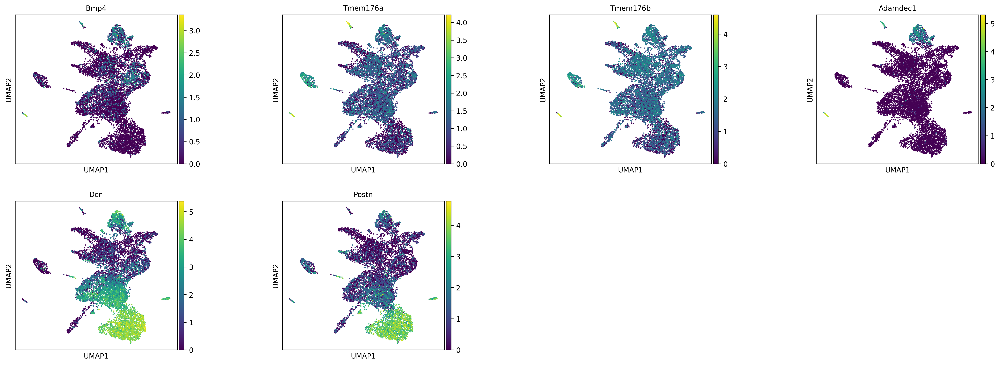

In [142]:
sc.pl.umap(intestine_muscle, color=['Bmp4', "Tmem176a", "Tmem176b", "Adamdec1", "Dcn", "Postn"], wspace=0.5)

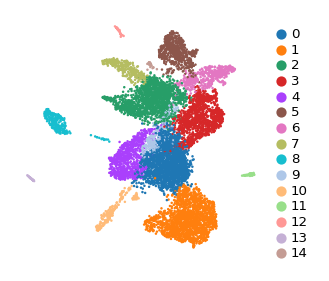

In [388]:
sc.settings.set_figure_params(dpi=80, dpi_save= 300, fontsize=6, facecolor='white', frameon=True, figsize=(1.6, 1.6), vector_friendly = False, transparent=True, format="pdf")
fig, ax = plt.subplots(figsize = (2.0, 2.0))
sc.pl.umap(intestine_muscle, size=5, color = ['muscle_leiden_0.5'], legend_fontsize=6, frameon=False, title="", show=False, ax = ax)
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 0.6, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
plt.savefig("figures/intestine_muscle_celltypes_umap.pdf")
sc.settings.set_figure_params(dpi=80, dpi_save= 300, fontsize=6, facecolor='white', frameon=True, figsize=(3.0, 3.0), vector_friendly = False, transparent=True, format="pdf")

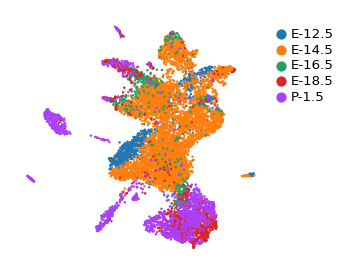

In [390]:
sc.settings.set_figure_params(dpi=80, dpi_save= 300, fontsize=6, facecolor='white', frameon=True, figsize=(1.6, 1.6), vector_friendly = False, transparent=True, format="pdf")
fig, ax = plt.subplots(figsize = (2.0, 2.0))
sc.pl.umap(intestine_muscle, size=5, color = ['sample'], legend_fontsize=6, frameon=False, title="", show=False, ax = ax)
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 0.6, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
plt.savefig("figures/intestine_muscle_stage_umap.pdf")
sc.settings.set_figure_params(dpi=80, dpi_save= 300, fontsize=6, facecolor='white', frameon=True, figsize=(3.0, 3.0), vector_friendly = False, transparent=True, format="pdf")

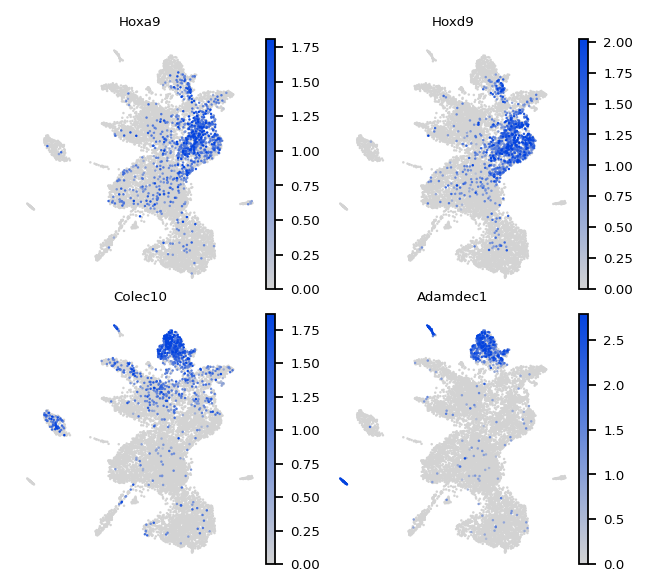

In [394]:
sc.settings.set_figure_params(dpi_save= 300, fontsize=6, figsize=(2.0,2.0), facecolor='white', frameon=True, vector_friendly = True, transparent=True, format="pdf")
sc.pl.umap(intestine_muscle, size = 5, color = ["Hoxa9", "Hoxd9", "Colec10", "Adamdec1"], legend_loc="none", cmap=sns.blend_palette(["lightgray", sns.xkcd_rgb["blue"]], as_cmap=True), frameon=False,  vmin=0, vmax='p99.2', ncols=2, wspace=0.15, hspace=0.1, save="colon_markers_muscle")

In [ ]:
sc.tl.rank_genes_groups(intestine_muscle, method="wilcoxon", groupby="muscle_leiden_0.5", key_added="rank_genes_groups_muscle_leiden_0.5")

ranking genes


In [ ]:
result = intestine_muscle.uns['rank_genes_groups_muscle_leiden_0.5']
groups = result['names'].dtype.names
celltype_markers = pd.DataFrame(
    {'group + '_' + key[:-1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges','pvals']}).head(100)
celltype_markers

In [ ]:
celltype_markers.to_csv("./../../../csvs_github/intestine_muscle_markers_top100.csv", index=False)

In [16]:
# intestine_muscle.write_h5ad("./../../../pyobjs_github/intestine_muscle.h5ad")

In [17]:
intestine_muscle = sc.read_h5ad("./../../../pyobjs_github/intestine_muscle.h5ad")
intestine_muscle

AnnData object with n_obs × n_vars = 9445 × 2375
    obs: 'sample', 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase', 'leiden_0.3', 'leiden_0.5', 'muscle_leiden_0.5'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_0.3_colors', 'leiden_0.5_colors', 'leiden_0.5_sizes', 'muscle_leiden_0.5_colors', 'neighbors', 'paga', 'pca', 'rank_genes_groups_muscle_leiden_0.5', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [190]:
small_muscle = intestine_muscle.raw.to_adata()[~intestine_muscle.obs['muscle_leiden_0.5'].isin(["3", "5", "11", "12", "13", "14"])]
small_muscle.shape

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


(7519, 19652)

extracting highly variable genes
    finished (0:00:06)


Trying to set attribute `.uns` of view, copying.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


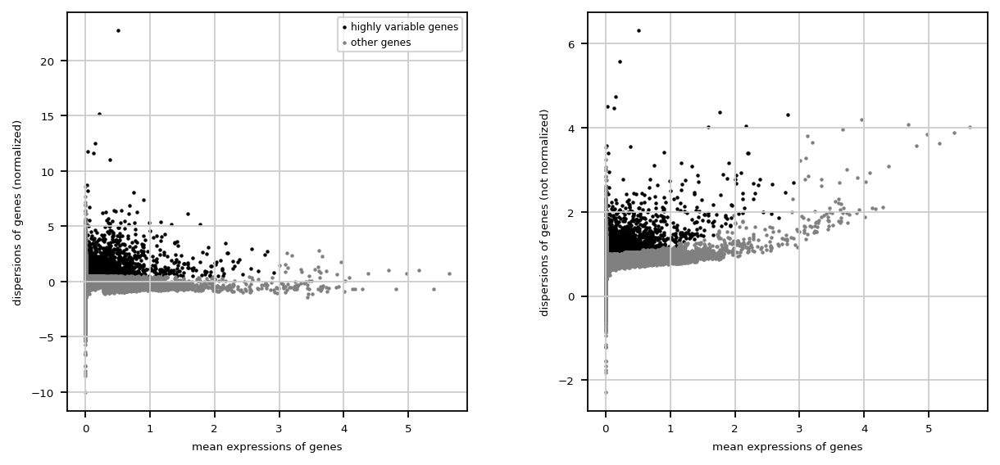

regressing out ['total_counts', 'pct_counts_mt', 'S_score', 'G2M_score']
    sparse input is densified and may lead to high memory use
    finished (0:02:22)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)


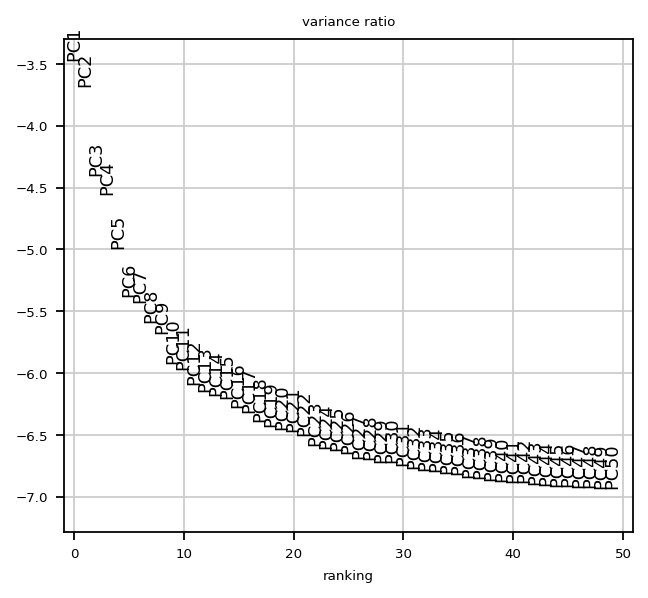

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:16)
running Leiden clustering
    finished: found 10 clusters and added
    'muscle_leiden_0.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 11 clusters and added
    'muscle_leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:00)


In [191]:
sc.pp.highly_variable_genes(small_muscle, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(small_muscle)
small_muscle.raw = small_muscle
small_muscle = small_muscle[:, small_muscle.var.highly_variable]
sc.pp.regress_out(small_muscle, ['total_counts', 'pct_counts_mt', 'S_score', 'G2M_score'], n_jobs=20)
sc.pp.scale(small_muscle, max_value=10)
sc.tl.pca(small_muscle, random_state=0)
sc.pl.pca_variance_ratio(small_muscle, n_pcs = 50, log=True)
sc.pp.neighbors(small_muscle, n_pcs=30)
sc.tl.umap(small_muscle)
sc.tl.leiden(small_muscle, key_added="muscle_leiden_0.5", resolution = 0.5)
sc.tl.leiden(small_muscle, key_added="muscle_leiden_0.6", resolution = 0.6)

In [192]:
sc.tl.leiden(small_muscle, key_added="muscle_leiden_0.7", resolution = 0.7)

running Leiden clustering
    finished: found 14 clusters and added
    'muscle_leiden_0.7', the cluster labels (adata.obs, categorical) (0:00:00)


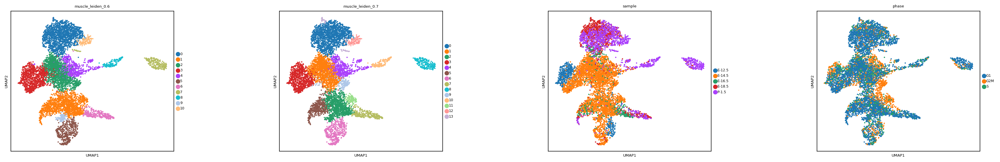

In [193]:
sc.pl.umap(small_muscle, color=["muscle_leiden_0.6","muscle_leiden_0.7", "sample", "phase"], wspace=0.5)

In [33]:
sc.tl.rank_genes_groups(small_muscle, groupby="muscle_leiden_0.7", method='wilcoxon', key_added="rank_genes_groups_small_muscle_leiden_0.7")

ranking genes
    finished: added to `.uns['rank_genes_groups_small_muscle_leiden_0.7']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


In [259]:
result = small_muscle.uns['rank_genes_groups_small_muscle_leiden_0.7']
groups = result['names'].dtype.names
celltype_markers = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names']}).head(40)
celltype_markers

,0_n,1_n,2_n,3_n,4_n,5_n,6_n,7_n,8_n,9_n,10_n,11_n,12_n,13_n
0,Dcn,Ptn,Meis2,Peg3,Ptma,Acta2,Acta2,Etv1,Col4a1,H2afz,Tagln,Hmgb2,Col1a2,Sparc
1,Postn,Cdkn1c,Rps14,Isl1,Tubb5,Myl6,Actg2,Kit,Col18a1,Stmn1,Myl9,H2afz,Col3a1,Itm2b
2,Col3a1,Mdk,Mab21l2,Nnat,Fabp5,Myl9,Mylk,Foxf1,Igfbp7,H2afv,Igfbp7,Stmn1,Col1a1,Sptbn1
3,Col1a2,Dlk1,Foxp2,Stmn2,Wnt4,Mylk,Myl6,Nrp2,Col4a2,Cenpa,Acta2,Pclaf,Dcn,App
4,Col1a1,Sfrp2,Rps16,Mdk,Ppia,Tpm1,Myl9,Chchd10,Pdgfrb,Birc5,Crip1,Tubb5,Bgn,Igfbp7
5,Gsn,Rpl12,Mpped2,Palld,H2afz,Tagln,Cald1,mt-Nd4,Myh9,Tubb4b,Mcam,Top2a,Postn,Nid1
6,S100a6,Rpl27a,Rpl18a,Sfrp1,Nr2f2,Cnn2,Tpm1,mt-Cytb,Rgs5,Selenoh,Cald1,Ptma,Mgp,Tagln2
7,Col6a1,Sulf2,Hsp90ab1,Hsp90ab1,Rbm3,Tpm2,Foxf1,Cpe,Ebf1,Ccnb2,Myh11,Spc24,Thbs2,S100a10
8,Lum,Calr,Foxp1,Nr2f2,Cdc7,Psd,Myh11,Ap1s2,Gm13889,Ran,Tpm1,H2afv,Igfbp7,Col5a1
9,Mfap5,Rps23,Npm1,Capn6,Sept7,Id2,Dstn,Enpep,Mcam,Dynll1,Mustn1,Ran,Sparc,Crip1


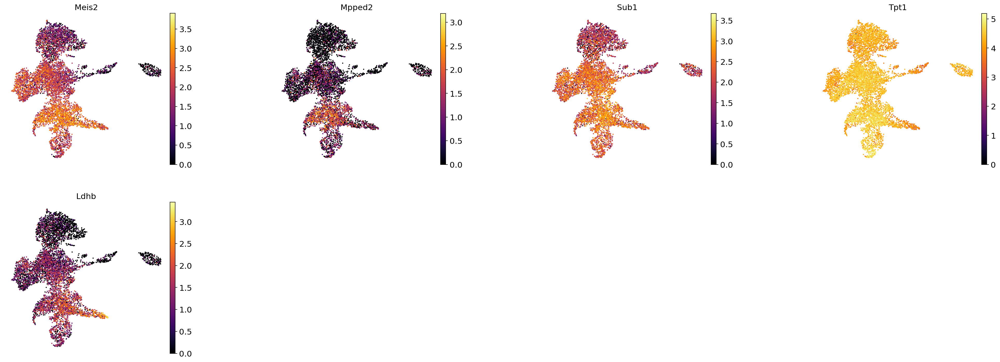

In [696]:
sc.pl.umap(small_muscle, color = ["Meis2","Mpped2","Sub1","Tpt1","Ldhb"], wspace=0.5, cmap="inferno")


In [97]:
small_muscle.obs["clusters_muscle_leiden_0.7"] = small_muscle.obs["muscle_leiden_0.7"]
celltypes = {'0': "Pdgfra+ fibroblast-like cells", 
             '1': "Mesenchymal progenitors-2", 
            '2': "Gut wall mesenchymal progenitors", 
            '3': "Mesenchymal progenitors-1", 
            '4': "Mesenchymal progenitors-3", 
            '5': "SM-1 (Gut wall)", 
            '6': "SM-2 (Gut wall)",
            '7': "Interstetial cells of Cajal (ICC)",
            '8': "Pericytes",
            '9': "Mesenchymal progenitors-2",
            '10': "SM-3 (Villus)",
            '11': "Gut wall mesenchymal progenitors", 
            '12': "Tnc+ Acta-low myofibroblast-like cells",
            '13': "Pdgfra+ fibroblast-like cells"}
small_muscle.obs["clusters_muscle_leiden_0.7"] = small_muscle.obs["clusters_muscle_leiden_0.7"].map(celltypes).astype("category")

In [98]:
small_muscle.obs["clusters_muscle_leiden_0.7"] = small_muscle.obs["clusters_muscle_leiden_0.7"].astype("category")
small_muscle.obs["clusters_muscle_leiden_0.7"].cat.reorder_categories(
    new_categories = ["Mesenchymal progenitors-1",
            "Mesenchymal progenitors-2", 
            "Mesenchymal progenitors-3",
            "Gut wall mesenchymal progenitors", 
              "SM-1 (Gut wall)", 
            "SM-2 (Gut wall)",
            "Interstetial cells of Cajal (ICC)",
             "Pdgfra+ fibroblast-like cells", 
             "Tnc+ Acta-low myofibroblast-like cells",
            "SM-3 (Villus)",
             "Pericytes"], inplace = True)

<ipython-input-98-490187533a60>:2: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  small_muscle.obs["clusters_muscle_leiden_0.7"].cat.reorder_categories(


computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


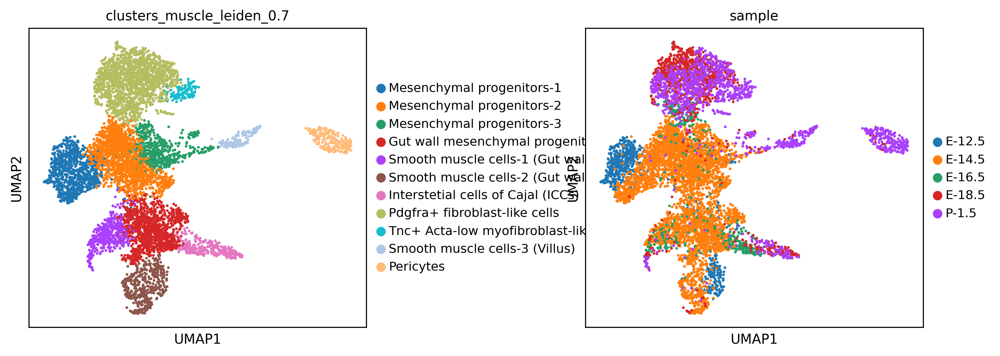

In [25]:
sc.tl.umap(small_muscle)
sc.pl.umap(small_muscle, color = ["clusters_muscle_leiden_0.7", "sample"], wspace=0.5)

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


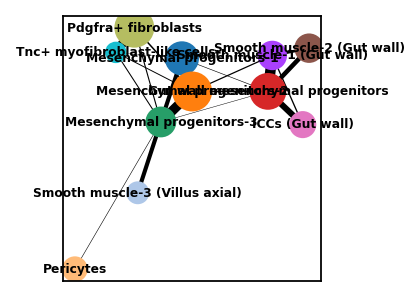

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:19)


In [239]:
sc.tl.paga(small_muscle, groups="clusters_muscle_leiden_0.7")
sc.pl.paga(small_muscle, threshold=0.014)
sc.tl.umap(small_muscle, init_pos="paga")

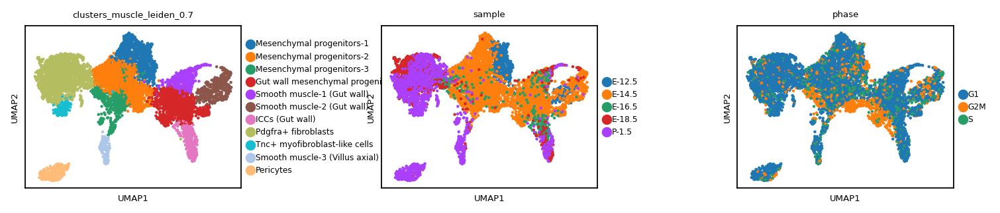

In [240]:
sc.pl.umap(small_muscle, color = ["clusters_muscle_leiden_0.7", "sample", "phase"], wspace=0.5)

--> added 'pos', the PAGA positions (adata.uns['paga'])


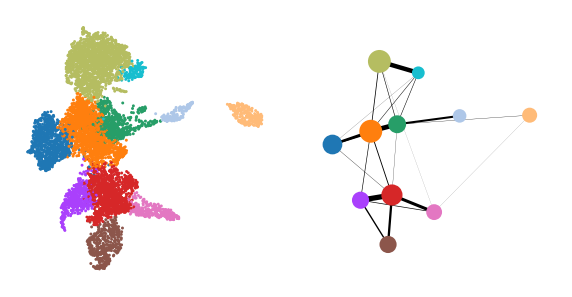

In [247]:
sc.settings.set_figure_params(dpi=80, dpi_save= 300, fontsize=6, facecolor='white', frameon=True, figsize=(2.5, 2.0), vector_friendly = False, transparent=True, format="pdf")
sc.pl.paga_compare(small_muscle, legend_loc= "none", size = 7, labels = ["" for x in np.unique(small_muscle.obs["clusters_muscle_leiden_0.7"])], node_size_scale = 0.3, edge_width_scale = 0.5, title="", title_graph="", save="small_muscle_scatter_paga_compare")

In [48]:
sc.settings.set_figure_params(dpi_save= 1000,dpi=300, fontsize=40, figsize=(5.0,5.0), facecolor='white', frameon=False, vector_friendly = False, transparent=True, format="png")
sc.pl.umap(small_muscle, color = ["Rspo1", "Rspo2", "Rspo3",'Wnt2b', 'Wnt4', "Wnt5a", "Wnt5b",'Dkk1','Dkk2', "Dkk3", "Sfrp1", "Sfrp2", "Frzb", "Wif1",'Bmp2', 'Bmp4', 'Bmp5', "Bmp6", "Bmp7",'Nog', "Chrd", "Grem1"], legend_loc="none",ncols=3,wspace=0.15, hspace=0.5, cmap=sns.blend_palette(["lightgray", sns.xkcd_rgb["red"]], as_cmap=True))

In [36]:
sc.settings.set_figure_params(dpi_save= 1000,dpi=300, fontsize=30,  facecolor='white', frameon=False, vector_friendly = False, transparent=True, format="png")
sc.pl.umap(small_muscle, color = ["Acta2","Myh11","Foxp2","Tgfbi","Kit","Etv1","Pdgfra","Postn","Tnc","Vegfd","Notch3","Mef2c","Pdgfrb","Cspg4"], legend_loc="none",ncols=2,hspace=0.4,wspace=0.18,vmin=0, vmax='p99.9',cmap=sns.blend_palette(["lightgray", sns.xkcd_rgb["red"]], as_cmap=True))

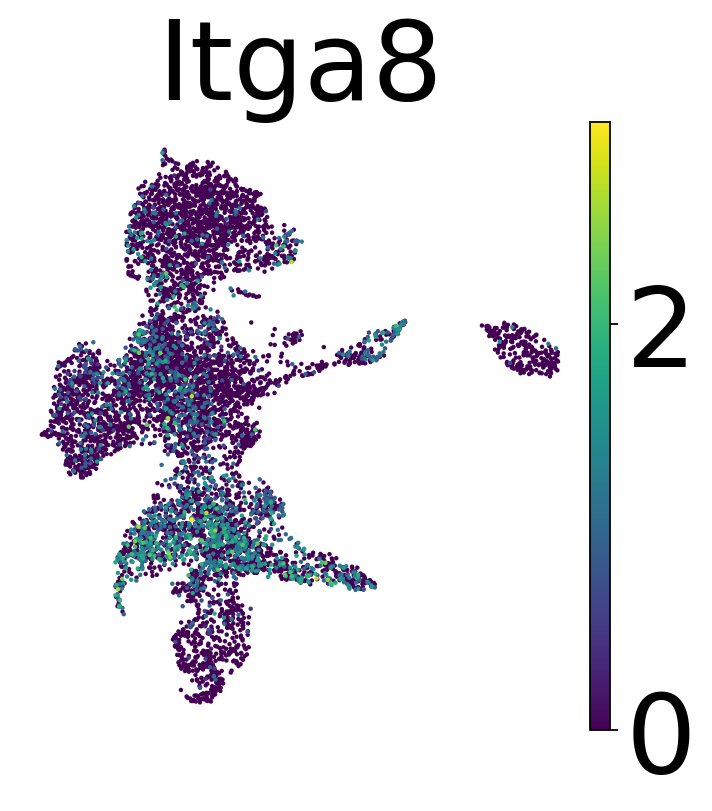

In [47]:
sc.settings.set_figure_params(dpi_save= 300, fontsize=50, figsize=(5.0,5.0), facecolor='white', frameon=False, vector_friendly = True, transparent=True, format="png")
sc.pl.umap(small_muscle, color = ["Itga8"], legend_loc="none",ncols=2,wspace=0.15, hspace=0.5)

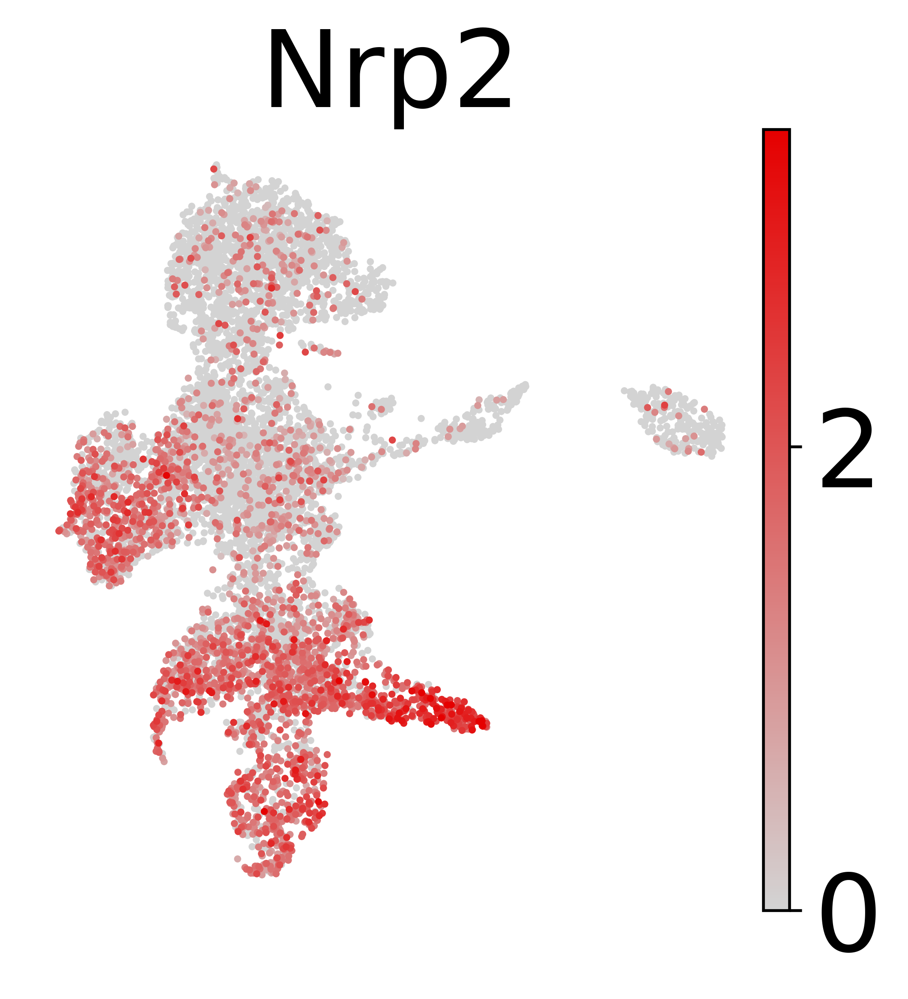

In [50]:
sc.settings.set_figure_params(dpi_save= 1000,dpi=300, fontsize=30,  facecolor='white', frameon=False, vector_friendly = False, transparent=True, format="png")
sc.pl.umap(small_muscle, color = ["Nrp2"], legend_loc="none",ncols=2,hspace=0.4,wspace=0.18,vmin=0, vmax='p99.9',cmap=sns.blend_palette(["lightgray", sns.xkcd_rgb["red"]], as_cmap=True))

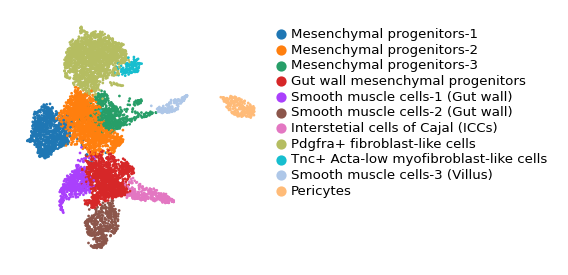

In [26]:
sc.settings.set_figure_params(dpi=80, dpi_save= 300, fontsize=6, facecolor='white', frameon=True, figsize=(2.0, 2.0), vector_friendly = False, transparent=True, format="pdf")
fig, ax = plt.subplots(figsize = (2.0, 2.0))
sc.pl.umap(small_muscle, color = ['clusters_muscle_leiden_0.7'], size=6, legend_fontsize=6, frameon=False, title="", show=False, ax = ax)
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 0.6, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
# plt.tight_layout()
plt.savefig("figures/muscle_celltypes_umap.pdf")
sc.settings.set_figure_params(dpi=80, dpi_save= 300, fontsize=6, facecolor='white', frameon=True, figsize=(3.0, 3.0), vector_friendly = False, transparent=True, format="pdf")

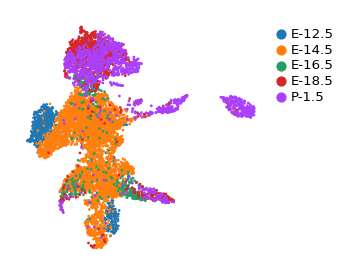

In [249]:
sc.settings.set_figure_params(dpi=80, dpi_save= 300, fontsize=6, facecolor='white', frameon=True, figsize=(2.0, 2.0), vector_friendly = False, transparent=True, format="pdf")
fig, ax = plt.subplots(figsize = (2.0, 2.0))
sc.pl.umap(small_muscle, color = ['sample'], size=6, legend_fontsize=6, frameon=False, title="", show=False, ax = ax)
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 0.6, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
# plt.tight_layout()
plt.savefig("figures/muscle_stage_umap.pdf")
sc.settings.set_figure_params(dpi=80, dpi_save= 300, fontsize=6, facecolor='white', frameon=True, figsize=(3.0, 3.0), vector_friendly = False, transparent=True, format="pdf")

In [99]:
small_muscle.write_h5ad("./../../../pyobjs_github/small_muscle.h5ad")

In [18]:
small_muscle = sc.read_h5ad("./../../../pyobjs_github/small_muscle.h5ad")

In [100]:
sc.tl.dendrogram(small_muscle, groupby="clusters_muscle_leiden_0.7")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_clusters_muscle_leiden_0.7']`


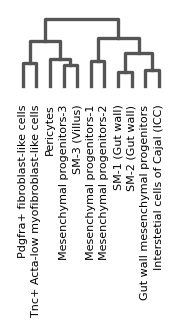

<AxesSubplot:>

In [101]:
sc.settings.set_figure_params(dpi_save= 400, fontsize=6, figsize=(1.2, 0.6), facecolor='white', frameon=True, transparent=True, format="pdf")
sc.pl.dendrogram(small_muscle, groupby="clusters_muscle_leiden_0.7", orientation="top", save="dendogram_muscle")

In [102]:
temp = small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin([
              "SM-1 (Gut wall)", 
            "SM-2 (Gut wall)",
            "SM-3 (Villus)"])]
sc.tl.rank_genes_groups(temp, groupby="clusters_muscle_leiden_0.7", key_added="rank_genes_groups_clusters_muscle_leiden_0.7_SM_only")

ranking genes


/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups_clusters_muscle_leiden_0.7_SM_only']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


In [103]:
result = temp.uns['rank_genes_groups_clusters_muscle_leiden_0.7_SM_only']
groups = result['names'].dtype.names
celltype_markers = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges','pvals']}).head(40)
celltype_markers

,SM-1 (Gut wall)_n,SM-1 (Gut wall)_l,SM-1 (Gut wall)_p,SM-2 (Gut wall)_n,SM-2 (Gut wall)_l,SM-2 (Gut wall)_p,SM-3 (Villus)_n,SM-3 (Villus)_l,SM-3 (Villus)_p
0,Dlk1,2.957463,7.744168e-172,Hmga2,3.823776,3.490594e-122,Igfbp7,7.612116,4.726646e-153
1,Ptn,2.728134,6.204374e-157,Igfbp2,3.138566,1.110476e-94,Crip1,8.949166,9.188066e-133
2,Alcam,4.243528,2.637361e-132,Stmn1,2.250068,2.564124e-86,Mcam,6.331702,2.235881e-119
3,Osr1,4.975711,2.267536e-101,Foxf1,2.063469,1.786733e-81,Aoc3,6.327519,1.838957e-93
4,Meg3,1.859249,8.998877e-117,Actg2,2.124540,9.058144e-70,Mustn1,5.822827,1.337963e-97
5,Smoc2,2.863727,5.069486e-96,Aldh1a2,4.296706,1.912633e-59,Mef2c,5.389186,3.849846e-96
6,Id2,2.448772,7.099069e-90,Aldh1a1,3.158207,1.486885e-61,S100a11,3.789565,3.133189e-119
7,Col6a1,2.103640,2.207784e-78,Mgst3,2.178497,3.447049e-62,Cavin3,3.629213,4.986259e-123
8,Mfap4,2.112006,2.254230e-78,Lmo4,2.173808,9.335719e-55,Notch3,5.898682,6.940324e-83
9,Cdkn1c,1.719966,4.409909e-70,Hmgb3,1.991548,7.189147e-55,Cavin1,4.305023,3.093583e-94


In [104]:
sc.tl.dendrogram(temp, groupby="clusters_muscle_leiden_0.7")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_clusters_muscle_leiden_0.7']`


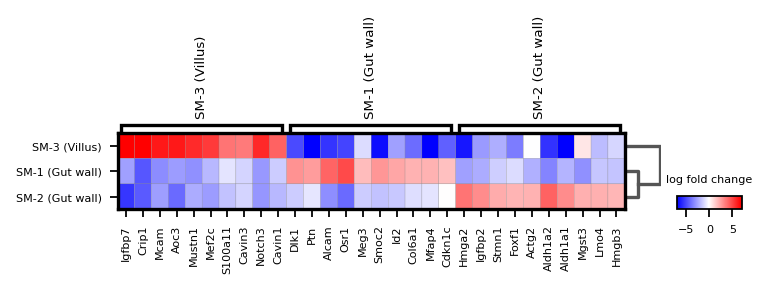

In [105]:
sc.settings.set_figure_params(dpi=80, dpi_save= 600, fontsize=6, frameon=True, figsize=(3, 3), transparent=True, vector_friendly = False, format="pdf")
fig, ax = plt.subplots(figsize = (5,1.5))
sc.pl.rank_genes_groups_matrixplot(temp, n_genes=10, key="rank_genes_groups_clusters_muscle_leiden_0.7_SM_only", values_to_plot='logfoldchanges', min_logfoldchange=1.0, vmax=7, vmin=-7, cmap='bwr', show=False, ax=ax)
# plt.tight_layout()
plt.savefig("./figures/smooth_muscle_dotplot.pdf")

In [106]:
sc.tl.rank_genes_groups(small_muscle, groupby="clusters_muscle_leiden_0.7", method='wilcoxon', key_added="rank_genes_groups_clusters_muscle_leiden_0.7")

ranking genes
    finished: added to `.uns['rank_genes_groups_clusters_muscle_leiden_0.7']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:09)


In [107]:
result = small_muscle.uns['rank_genes_groups_clusters_muscle_leiden_0.7']
groups = result['names'].dtype.names
celltype_markers = pd.DataFrame(
    {group + '_' + key[:-1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges','pvals']}).head(40)
celltype_markers

,Mesenchymal progenitors-1_name,Mesenchymal progenitors-1_logfoldchange,Mesenchymal progenitors-1_pval,Mesenchymal progenitors-2_name,Mesenchymal progenitors-2_logfoldchange,Mesenchymal progenitors-2_pval,Mesenchymal progenitors-3_name,Mesenchymal progenitors-3_logfoldchange,Mesenchymal progenitors-3_pval,Gut wall mesenchymal progenitors_name,...,Pdgfra+ fibroblast-like cells_pval,Tnc+ Acta-low myofibroblast-like cells_name,Tnc+ Acta-low myofibroblast-like cells_logfoldchange,Tnc+ Acta-low myofibroblast-like cells_pval,SM-3 (Villus)_name,SM-3 (Villus)_logfoldchange,SM-3 (Villus)_pval,Pericytes_name,Pericytes_logfoldchange,Pericytes_pval
0,Isl1,4.905148,6.641737e-159,Mdk,1.218615,7.823475e-282,Wnt4,2.425440,2.210513e-68,Mab21l2,...,0.000000e+00,Bgn,2.989377,1.367735e-57,Mustn1,6.398448,1.292128e-93,Col18a1,7.049892,1.027289e-151
1,Peg3,1.886180,1.599424e-143,Ptn,1.392142,1.070532e-273,Tubb5,1.025982,5.402442e-64,Meis2,...,0.000000e+00,Eln,4.857492,1.466420e-57,Tagln,5.856213,8.805581e-93,Col4a1,4.321435,1.557215e-149
2,Nnat,1.936466,4.333903e-124,Cdkn1c,1.300731,2.635381e-270,Fabp5,1.586047,1.290484e-63,Foxp2,...,0.000000e+00,Thbs2,4.122994,1.906885e-56,Mcam,5.864310,6.327838e-91,Pdgfrb,4.705067,5.678353e-143
3,Stmn2,3.369707,8.765594e-123,Sfrp2,1.973101,1.152011e-192,Ptma,0.548977,5.125899e-56,Rps14,...,0.000000e+00,Mgp,4.123225,1.350647e-55,Crip1,5.241143,1.318236e-90,Rgs5,6.821733,1.172346e-140
4,Palld,1.943956,1.288456e-119,Calr,1.037320,3.100594e-171,Cdc7,1.970929,7.230733e-56,Mpped2,...,0.000000e+00,Col1a2,3.060120,3.367163e-54,Myl9,4.440641,2.211573e-90,Col4a2,3.904501,1.605891e-138
5,Sfrp1,1.686616,1.012821e-112,Rpl12,0.581512,8.560280e-162,Ppia,0.513145,8.172841e-52,Rps16,...,0.000000e+00,Col1a1,2.469776,1.546717e-47,Mef2c,4.903547,3.096189e-90,Myh9,4.501427,2.089857e-138
6,Nr2f2,1.433649,9.982521e-107,Rpl14,0.536194,1.615298e-157,Ybx1,0.698850,6.729419e-51,Foxp1,...,0.000000e+00,Fhl1,4.242340,1.630914e-45,Aoc3,5.392982,2.724578e-89,Igfbp7,4.515049,2.003978e-131
7,Capn6,2.172657,1.365833e-106,Rps19,0.583661,5.392138e-156,H2afz,1.100738,5.715705e-48,Col23a1,...,0.000000e+00,Igfbp7,3.535684,1.350890e-44,Cav1,5.684899,5.016793e-88,Gm13889,5.964197,1.589280e-123
8,Pitx2,3.260390,1.914030e-94,Sulf2,1.379084,1.597441e-152,Ran,0.941017,1.298141e-47,Tgfbi,...,0.000000e+00,Col14a1,3.408484,3.883721e-44,Myh11,5.705443,5.029668e-87,Mcam,5.424364,2.383050e-120
9,Hsp90ab1,0.686816,6.353817e-90,Rps23,0.611225,2.154529e-150,Rpsa,0.534784,7.993428e-46,Ldhb,...,0.000000e+00,Col3a1,2.228421,4.213107e-43,Cald1,2.770548,6.030910e-87,Sept4,6.351825,8.308936e-120


In [109]:
celltype_markers.to_csv("./../../mouse_intestine_development/csvs_github/small_muscle_celltype_markers_top100.csv", index=False)

In [112]:
marker_list = list()
for group in small_muscle.uns['rank_genes_groups_clusters_muscle_leiden_0.7']['names'].dtype.names:
    markers = sc.get.rank_genes_groups_df(small_muscle, key='rank_genes_groups_clusters_muscle_leiden_0.7', group = group).head(50)
    markers["celltypes"] = group
    marker_list.append(markers)

In [113]:
pd.concat(marker_list).to_csv("./../../mouse_intestine_development/csvs_github/Table2_new.csv", index=False)

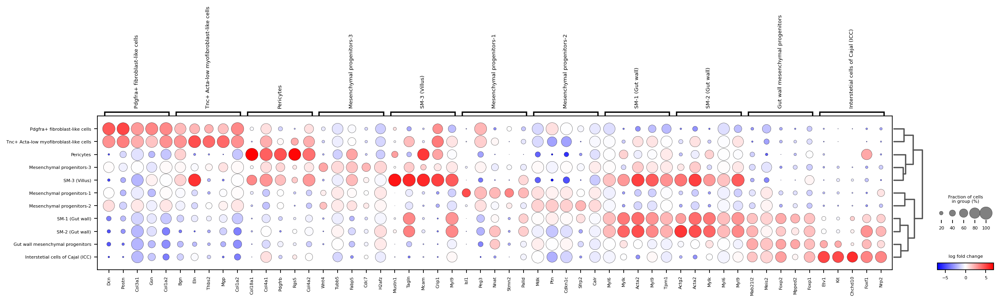

In [110]:
sc.settings.set_figure_params(dpi=80, dpi_save= 600, fontsize=6, frameon=True, figsize=(3, 3), transparent=True, vector_friendly = False, format="pdf")
fig, ax = plt.subplots(figsize = (18,4))
sc.pl.rank_genes_groups_dotplot(small_muscle, n_genes=5, key="rank_genes_groups_clusters_muscle_leiden_0.7", values_to_plot='logfoldchanges', min_logfoldchange=1.0, vmax=7, vmin=-7, cmap='bwr', show=False, ax=ax)
# plt.tight_layout()
plt.savefig("./figures/muscle_subclusters_dotplot.pdf")

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


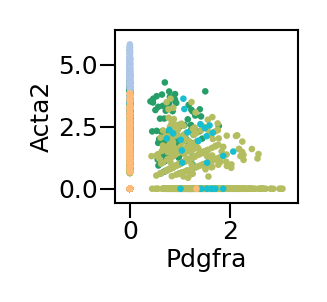

In [88]:
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=6, frameon=True, figsize=(2, 2), transparent=False, format="pdf")
fig, ax = plt.subplots(figsize = (1.0, 1.0))
plt.margins(x=0.1, y=0.1)
ax.tick_params(axis='both', which='major', pad=0.5)
plt.grid(b=None)
ax.set_axisbelow(True)
plt.setp(ax.spines.values(), linewidth=0.5)
ax.tick_params(width=0.5)
sc.pl.scatter(small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin(["Mesenchymal progenitors-3",
             "Pdgfra+ fibroblast-like cells", 
             "Tnc+ Acta-low myofibroblast-like cells",
            "Smooth muscle cells-3 (Villus)",
             "Pericytes"])], x="Pdgfra", y="Acta2", size=10, color="clusters_muscle_leiden_0.7", ax = ax, show=False, title="")
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 2.0, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
plt.xlabel("Pdgfra", labelpad=1)
plt.ylabel("Acta2", labelpad=1)
ax.get_legend().remove()

plt.tight_layout()
# plt.show()
plt.savefig("figures/scatter_Acta2_pdgfra.pdf", facecolor='w', edgecolor='w',
        orientation='potrait', format="pdf",
        transparent=True, metadata=None)

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


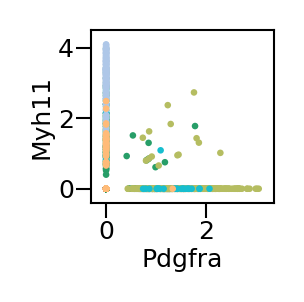

In [89]:
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=6, frameon=True, figsize=(2, 2), transparent=False, format="pdf")
fig, ax = plt.subplots(figsize = (1.0, 1.0))
plt.margins(x=0.1, y=0.1)
ax.tick_params(axis='both', which='major', pad=0.5)
plt.grid(b=None)
ax.set_axisbelow(True)
plt.setp(ax.spines.values(), linewidth=0.5)
ax.tick_params(width=0.5)
sc.pl.scatter(small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin(["Mesenchymal progenitors-3",
             "Pdgfra+ fibroblast-like cells", 
             "Tnc+ Acta-low myofibroblast-like cells",
            "Smooth muscle cells-3 (Villus)",
             "Pericytes"])], x="Pdgfra", y="Myh11", size=10, color="clusters_muscle_leiden_0.7", ax = ax, show=False, title="")
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 2.0, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
plt.xlabel("Pdgfra", labelpad=1)
plt.ylabel("Myh11", labelpad=1)
ax.get_legend().remove()
plt.tight_layout()
# plt.show()
plt.savefig("figures/scatter_myh11_pdgfra.pdf", facecolor='w', edgecolor='w',
        orientation='potrait', format="pdf",
        transparent=True, metadata=None)

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


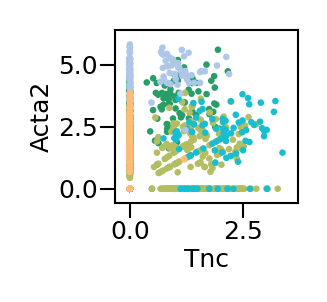

In [90]:
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=6, frameon=True, figsize=(2, 2), transparent=False, format="pdf")
fig, ax = plt.subplots(figsize = (1, 1))
plt.margins(x=0.1, y=0.1)
ax.tick_params(axis='both', which='major', pad=0.5)
plt.grid(b=None)
ax.set_axisbelow(True)
plt.setp(ax.spines.values(), linewidth=0.5)
ax.tick_params(width=0.5)
sc.pl.scatter(small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin(["Mesenchymal progenitors-3",
             "Pdgfra+ fibroblast-like cells", 
             "Tnc+ Acta-low myofibroblast-like cells",
            "Smooth muscle cells-3 (Villus)",
             "Pericytes"])], x="Tnc", y="Acta2", size=10, color="clusters_muscle_leiden_0.7", ax = ax, show=False, title="")
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 2.0, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
ax.get_legend().remove()
plt.xlabel("Tnc", labelpad=1)
plt.ylabel("Acta2", labelpad=1)
plt.tight_layout()
# plt.show()
plt.savefig("figures/scatter_acta2_Tnc.pdf", facecolor='w', edgecolor='w',
        orientation='potrait', format="pdf",
        transparent=True, metadata=None)

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


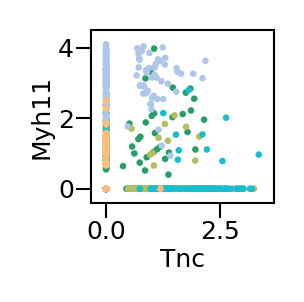

In [91]:
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=6, frameon=True, figsize=(2, 2), transparent=False, format="pdf")
fig, ax = plt.subplots(figsize = (1.0, 1.0))
plt.margins(x=0.1, y=0.1)
ax.tick_params(axis='both', which='major', pad=0.5)
plt.grid(b=None)
ax.set_axisbelow(True)
plt.setp(ax.spines.values(), linewidth=0.5)
ax.tick_params(width=0.5)
sc.pl.scatter(small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin(["Mesenchymal progenitors-3",
             "Pdgfra+ fibroblast-like cells", 
             "Tnc+ Acta-low myofibroblast-like cells",
            "Smooth muscle cells-3 (Villus)",
             "Pericytes"])], x="Tnc", y="Myh11", size=10, color="clusters_muscle_leiden_0.7", ax = ax, show=False, title="")
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 2.0, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
ax.get_legend().remove()

plt.xlabel("Tnc", labelpad=1)
plt.ylabel("Myh11", labelpad=1)
plt.tight_layout()
# plt.show()
plt.savefig("figures/scatter_tnc_myh11.pdf", facecolor='w', edgecolor='w',
        orientation='potrait', format="pdf",
        transparent=True, metadata=None)

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


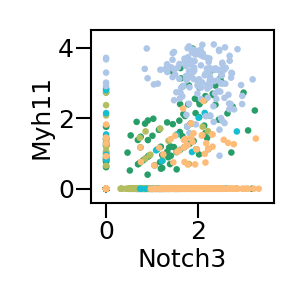

In [92]:
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=6, frameon=True, figsize=(2, 2), transparent=False, format="pdf")
fig, ax = plt.subplots(figsize = (1.0, 1.0))
plt.margins(x=0.1, y=0.1)
ax.tick_params(axis='both', which='major', pad=0.5)
plt.grid(b=None)
ax.set_axisbelow(True)
plt.setp(ax.spines.values(), linewidth=0.5)
ax.tick_params(width=0.5)
sc.pl.scatter(small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin(["Mesenchymal progenitors-3",
             "Pdgfra+ fibroblast-like cells", 
             "Tnc+ Acta-low myofibroblast-like cells",
            "Smooth muscle cells-3 (Villus)",
             "Pericytes"])], x="Notch3", y="Myh11", size=10, color="clusters_muscle_leiden_0.7", ax = ax, show=False, title="")
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 2.0, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
ax.get_legend().remove()

plt.xlabel("Notch3", labelpad=1)
plt.ylabel("Myh11", labelpad=1)
plt.tight_layout()
# plt.show()
plt.savefig("figures/scatter_notch3_myh11.pdf", facecolor='w', edgecolor='w',
        orientation='potrait', format="pdf",
        transparent=True, metadata=None)

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


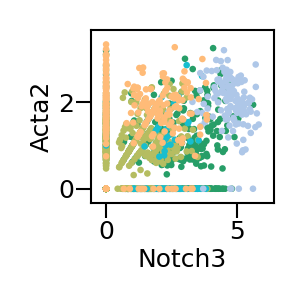

In [93]:
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=6, frameon=True, figsize=(2, 2), transparent=False, format="pdf")
fig, ax = plt.subplots(figsize = (1.0, 1.0))
plt.margins(x=0.1, y=0.1)
ax.tick_params(axis='both', which='major', pad=0.5)
plt.grid(b=None)
ax.set_axisbelow(True)
plt.setp(ax.spines.values(), linewidth=0.5)
ax.tick_params(width=0.5)
sc.pl.scatter(small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin(["Mesenchymal progenitors-3",
             "Pdgfra+ fibroblast-like cells", 
             "Tnc+ Acta-low myofibroblast-like cells",
            "Smooth muscle cells-3 (Villus)",
             "Pericytes"])], x="Acta2", y="Notch3", size=10, color="clusters_muscle_leiden_0.7", ax = ax, show=False, title="")
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 2.0, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
ax.get_legend().remove()

plt.xlabel("Notch3", labelpad=1)
plt.ylabel("Acta2", labelpad=1)
plt.tight_layout()
# plt.show()
plt.savefig("figures/scatter_notch3_Acta2.pdf", facecolor='w', edgecolor='w',
        orientation='potrait', format="pdf",
        transparent=True, metadata=None)

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


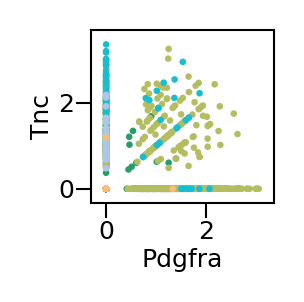

In [94]:
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=6, frameon=True, figsize=(2, 2), transparent=False, format="pdf")
fig, ax = plt.subplots(figsize = (1.0, 1.0))
plt.margins(x=0.1, y=0.1)
ax.tick_params(axis='both', which='major', pad=0.5)
plt.grid(b=None)
ax.set_axisbelow(True)
plt.setp(ax.spines.values(), linewidth=0.5)
ax.tick_params(width=0.5)
sc.pl.scatter(small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin(["Mesenchymal progenitors-3",
             "Pdgfra+ fibroblast-like cells", 
             "Tnc+ Acta-low myofibroblast-like cells",
            "Smooth muscle cells-3 (Villus)",
             "Pericytes"])], x="Pdgfra", y="Tnc", size=10, color="clusters_muscle_leiden_0.7", ax = ax, show=False, title="")
plt.legend(ncol=1, prop={'size': 6}, handletextpad=0.5, markerscale = 2.0, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.0,1.0))
ax.get_legend().remove()

plt.xlabel("Pdgfra", labelpad=1)
plt.ylabel("Tnc", labelpad=1)
plt.tight_layout()
# plt.show()
plt.savefig("figures/scatter_Prgfra_Tnc.pdf", facecolor='w', edgecolor='w',
        orientation='potrait', format="pdf",
        transparent=True, metadata=None)

In [58]:
sns_data = small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin([
            "Mesenchymal progenitors-3",
             "Pdgfra+ fibroblasts", 
             "Tnc+ myofibroblast-like cells",
            "Smooth muscle-3 (Villus axial)",
             "Pericytes"])].raw.to_adata().to_df()
print(sns_data.shape)
sns_data = sns_data.join(small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin([
            "Mesenchymal progenitors-3",
             "Pdgfra+ fibroblasts", 
             "Tnc+ myofibroblast-like cells",
            "Smooth muscle-3 (Villus axial)",
             "Pericytes"])].obs)
print(sns_data.shape)

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


(2680, 19652)
(2680, 19669)


In [85]:
color_set = small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin([
            "Mesenchymal progenitors-3",
             "Pdgfra+ fibroblasts", 
             "Tnc+ myofibroblast-like cells",
            "Smooth muscle-3 (Villus axial)",
             "Pericytes"])].raw.to_adata().uns['muscle_leiden_0.7_colors']

/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2631: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/home/mm2937/miniconda3/envs/python385/lib/python3.8/site-packages/seaborn/distributions.py:1078: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


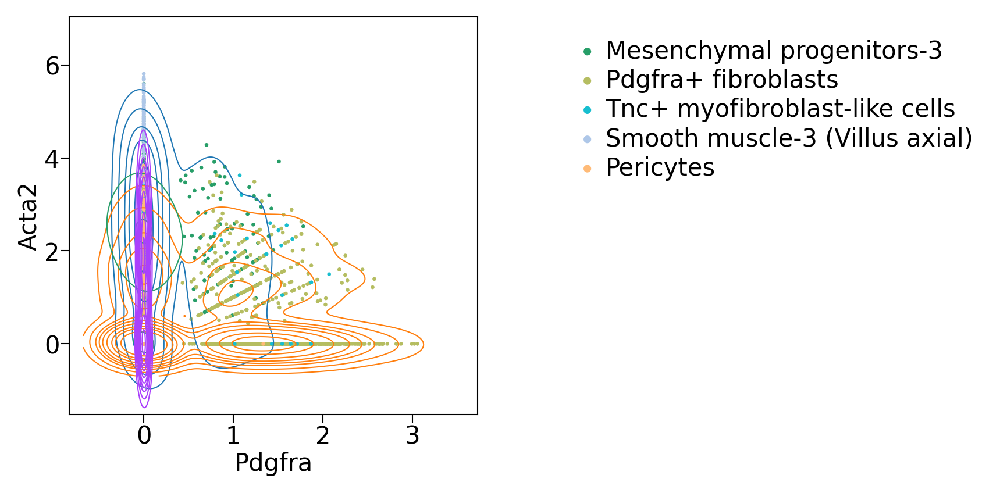

In [87]:
sc.settings.set_figure_params(dpi=150, dpi_save= 300, fontsize=10, frameon=True, figsize=(2, 2), transparent=False, format="pdf")
fig, ax = plt.subplots(figsize = (3.0, 3.0))
plt.rcParams["contour.linewidth"] = 0.5
plt.margins(x=0.1, y=0.1)
ax.tick_params(axis='both', which='major', pad=0.5)
plt.grid(b=None)
ax.set_axisbelow(True)
plt.setp(ax.spines.values(), linewidth=0.5)
ax.tick_params(width=0.5)
sc.pl.scatter(small_muscle[small_muscle.obs["clusters_muscle_leiden_0.7"].isin([
            "Mesenchymal progenitors-3",
             "Pdgfra+ fibroblasts", 
             "Tnc+ myofibroblast-like cells",
            "Smooth muscle-3 (Villus axial)",
             "Pericytes"])], x="Pdgfra", y="Acta2", size=10, color="clusters_muscle_leiden_0.7", ax = ax, show=False, title="")
sns.kdeplot(data=sns_data, x="Pdgfra", y="Acta2", hue="clusters_muscle_leiden_0.7")
plt.legend(ncol=1, prop={'size': 10}, handletextpad=0.5, markerscale = 2.0, frameon = False, labelspacing = 0.2, bbox_to_anchor = (1.2,1.0))
plt.xlabel("Pdgfra", labelpad=1)
plt.ylabel("Acta2", labelpad=1)
# ax.get_legend().remove()
# plt.tight_layout()
plt.show()